In [1]:
import matplotlib.pyplot as plt
import numpy as np
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
%run Pendulum_on_Cart_Optimization.py

5.999999879565881
5.999999879565881
5.999999933316876
5.99999989044254
5.999999783855914
5.999970683164694
5.9999995986288175
5.999999877837374
5.999999879607462
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.00229798760038497
            Iterations: 1
            Function evaluations: 9
            Gradient evaluations: 1
[0.5779675207590408, 1.552409515734169, -0.4331378319750138]


In [3]:
#from __future__ import division

x_best = [0.5779675207590408, 1.552409515734169, -0.4331378319750138]

x_non = [0.2907024 ,  1.25874185, -9.21011835] #unoptimized 7 sec

total_time = 7
def angle(x_param):
    t_max = 30.0
    dt = 0.03
    
    t = 0.0
    g = 9.81
    L = 1
    alpha = 0.3
    theta = np.pi
    theta_velocity = 0
    theta_acc = 0
    
    xopt = x_param
    
    x_acc = xopt[0]
    constant_velocity = xopt[1]
    x_decc = xopt[2]
    
    constant_velocity_start_time = constant_velocity/x_acc
    decceleration_start_time = total_time + constant_velocity/x_decc
    
    displacement =  (0.5*constant_velocity_start_time*constant_velocity +
                            constant_velocity*(decceleration_start_time-constant_velocity_start_time) +
                            0.5*(total_time-decceleration_start_time)*constant_velocity)
    print(displacement)             
    x_velocity = 0
    x_position = 0
    
    x = x_position + L*np.sin(theta)
    y = L*np.cos(theta)
    x_list = [x]
    y_list = [y]
    t_list = []
    x_position_list = []
    theta_list = []
    stop = False
    while t < t_max:
        
        x_acc = x_acc
        if t >= constant_velocity_start_time and t < decceleration_start_time:
            x_acc = 0
            x_velocity = constant_velocity
        if t >=decceleration_start_time:
            x_acc = x_decc
        if x_velocity < 0:
            stop = True
        if stop:
            x_velocity = 0
            x_acc = 0
            
        x_velocity = x_velocity + x_acc*dt
        x_position = x_position + x_velocity*dt        
        
        theta_acc = (-x_acc*np.cos(theta) + g*np.sin(theta))/(1*L) - alpha*theta_velocity/(1*L**2)
        theta_velocity = theta_velocity + theta_acc*dt
        theta = theta + theta_velocity*dt           
        x = x_position + L*np.sin(theta)
        y = L*np.cos(theta)
        t_list.append(t)
        x_list.append(x)
        y_list.append(y)
        x_position_list.append(x_position)
        theta_list.append(theta)
        t = t + dt
    return x_list, y_list, t_list, x_position_list, theta_list

In [4]:
P0 = angle(x_non)
P = angle(x_best)

6.000000072234685
5.999999879607462


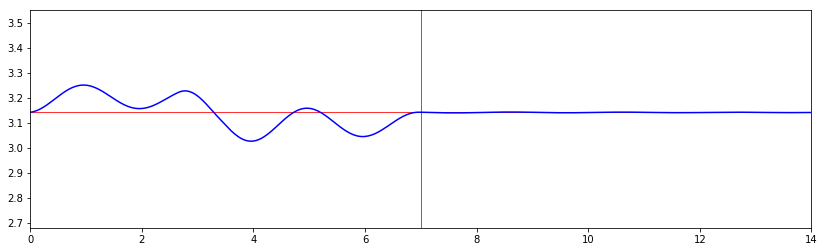

In [5]:
plt.figure(figsize=(14,4))
plt.fill_between(np.array(P[2])[234:],np.array(P[4])[234:], y2=np.pi, color='r', alpha=0.2)
plt.plot(P[2],P[4], color='b')
plt.vlines(7,0,4, lw = 0.8, color='g')
plt.hlines(np.pi,0,15, lw=0.8, color='r')
plt.xlim(0,14)
plt.ylim(2.68,3.55)
plt.show()


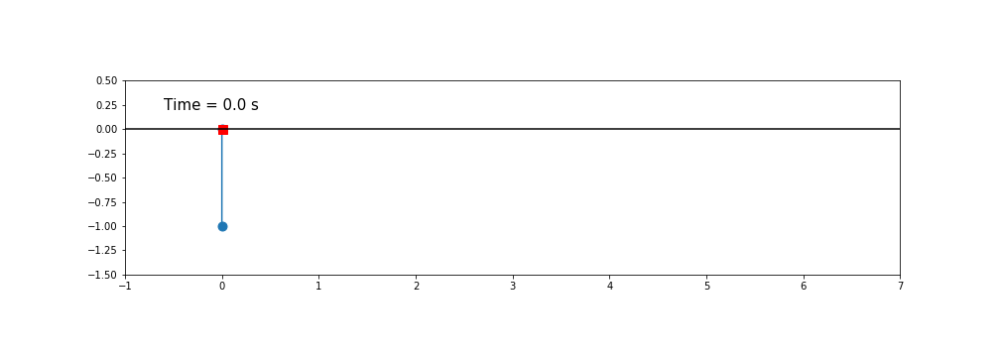
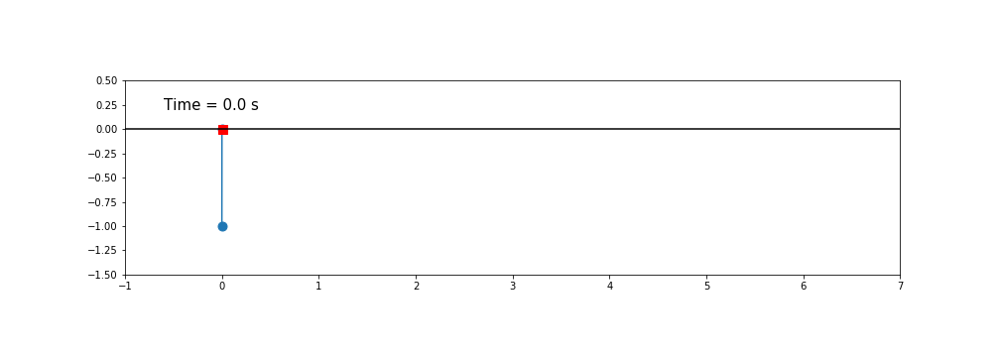
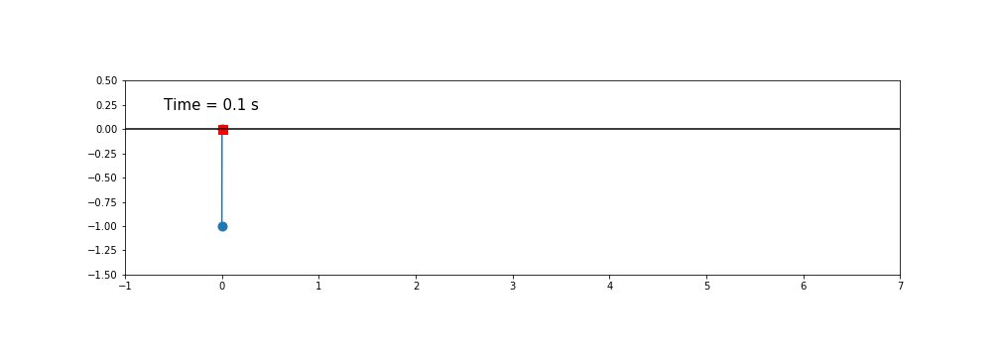
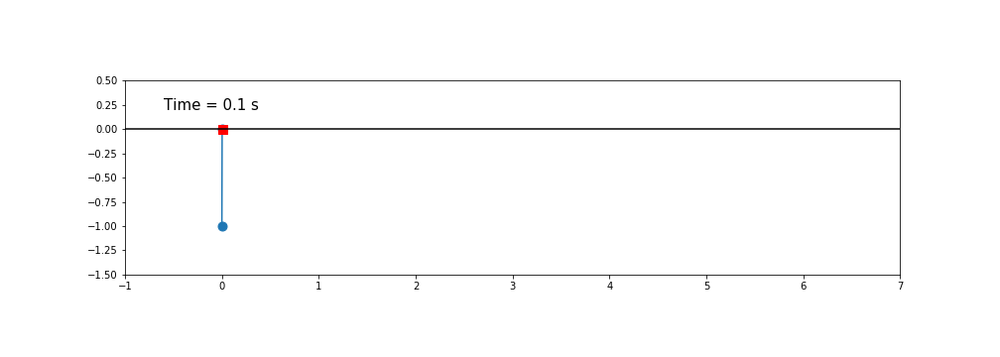
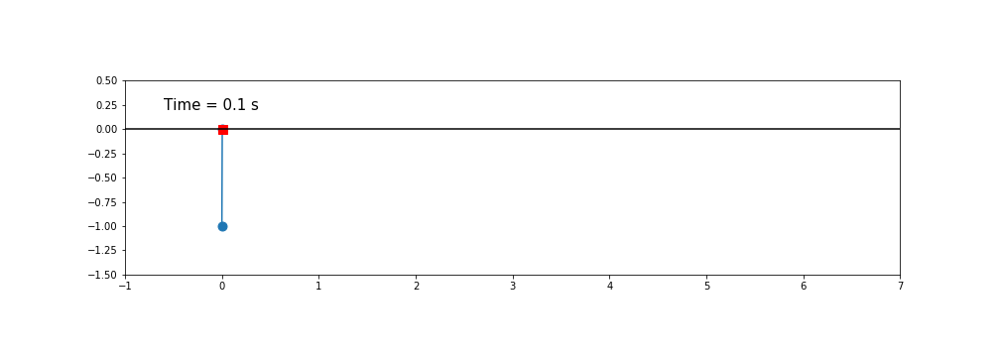
...
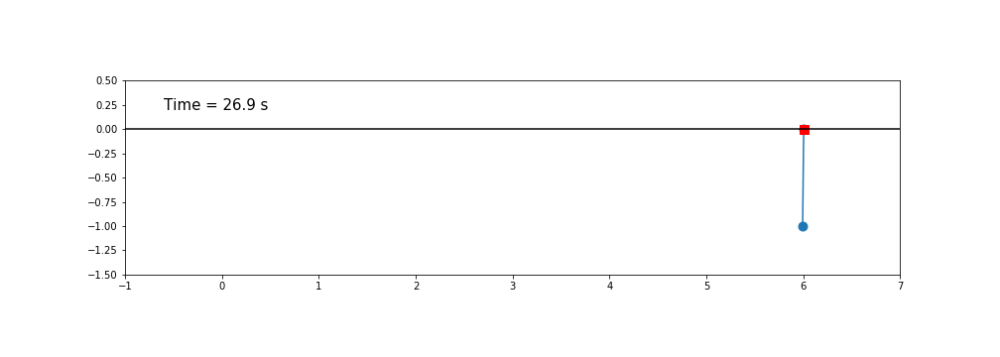
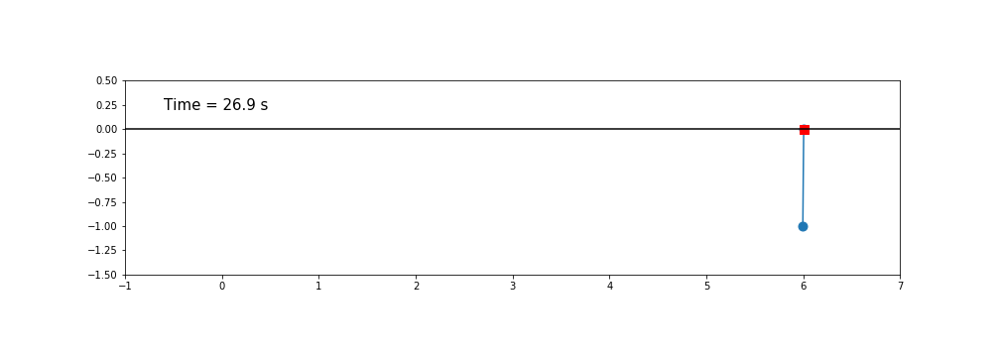
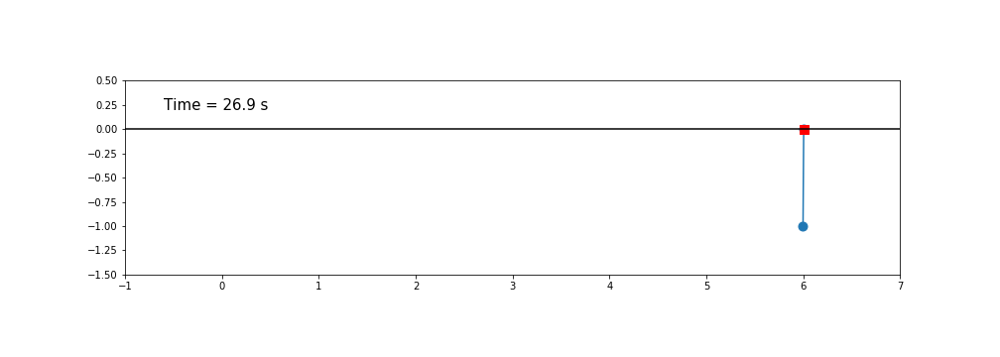
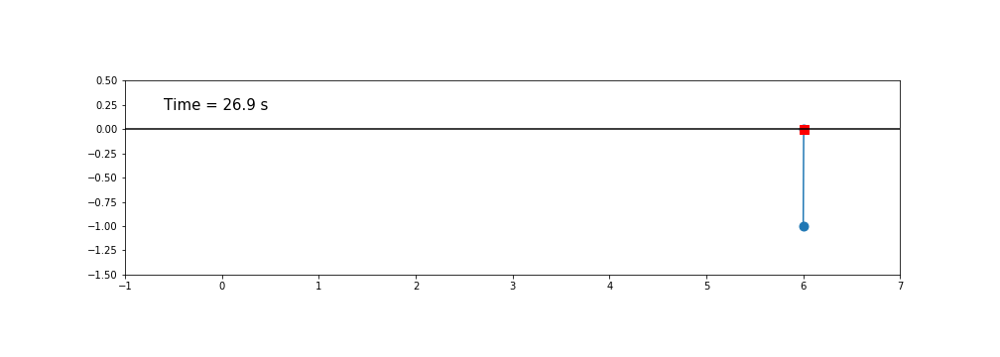
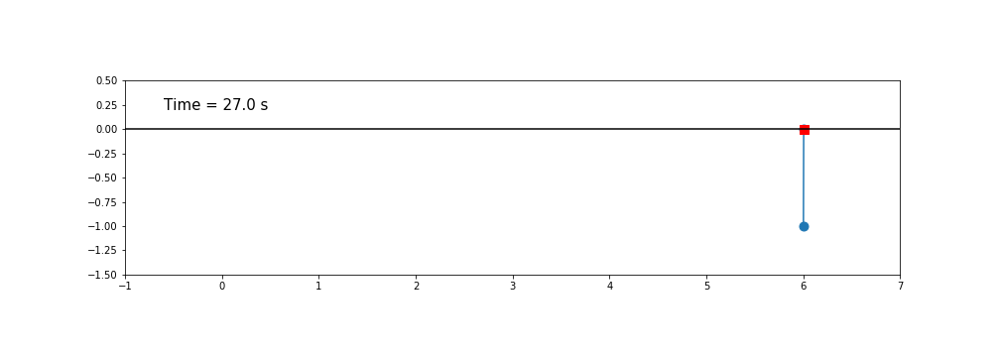

In [6]:
# JSAnimation import available at https://github.com/jakevdp/JSAnimation
from JSAnimation import IPython_display
from matplotlib import animation

# create a simple animation
fig = plt.figure(figsize=(14,5))


ax = plt.subplot(1,1,1)
line1, = ax.plot([], [],'-o',ms = 9)
line2, = ax.plot([], [],'-s',ms = 9, color = 'red')
ax.axhline(0,color='black')

plt.xlim(-1,7)
plt.ylim(-1.5,0.5)
ax.set_aspect('equal')

time_template = 'Time = %.1f s'    # prints running simulation time
time_text = ax.text(0.05, 0.85, '', transform=ax.transAxes, size =15)


def init():
    line1.set_data([], [])
    
    return line1,

def animate(i):
    line1.set_data([P0[0][i],P0[3][i]], [P0[1][i],0])
    line2.set_data(P0[3][i],0)
    time_text.set_text(time_template%(P0[2][i]))
    return line1,

animation.FuncAnimation(fig, animate, init_func=init,
                        frames=900, interval=40, blit=True)


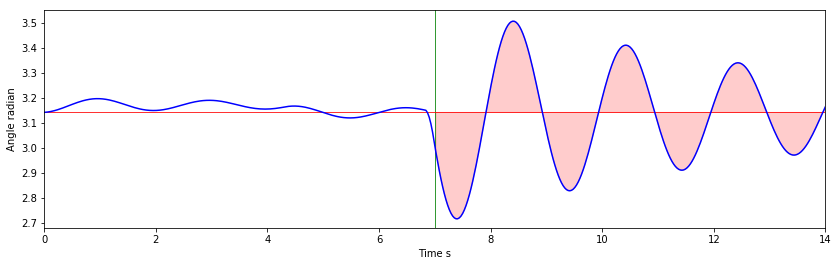

In [7]:
plt.figure(figsize=(14,4))
plt.fill_between(np.array(P0[2])[234:],np.array(P0[4])[234:], y2=np.pi, color='r', alpha=0.2)
plt.plot(P0[2],P0[4], color='b')
plt.vlines(7,0,4, lw = 0.8, color='g')
plt.hlines(np.pi,0,15, lw=0.8, color='r')
plt.xlim(0,14)
plt.ylim(2.68,3.55)
plt.xlabel("Time s")
plt.ylabel("Angle radian")
plt.show()


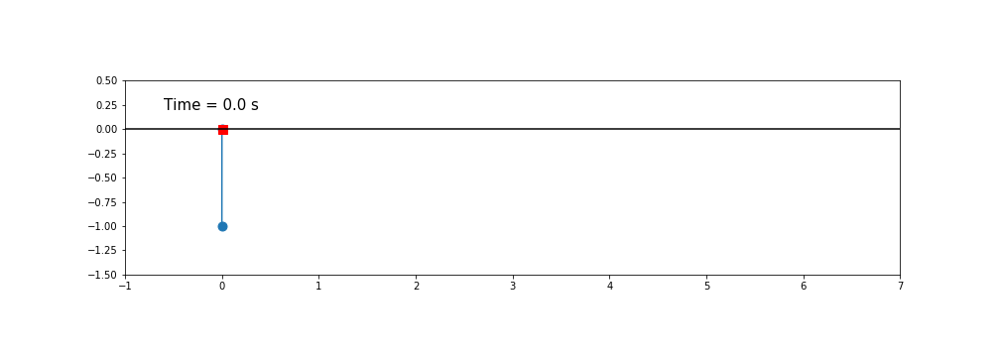
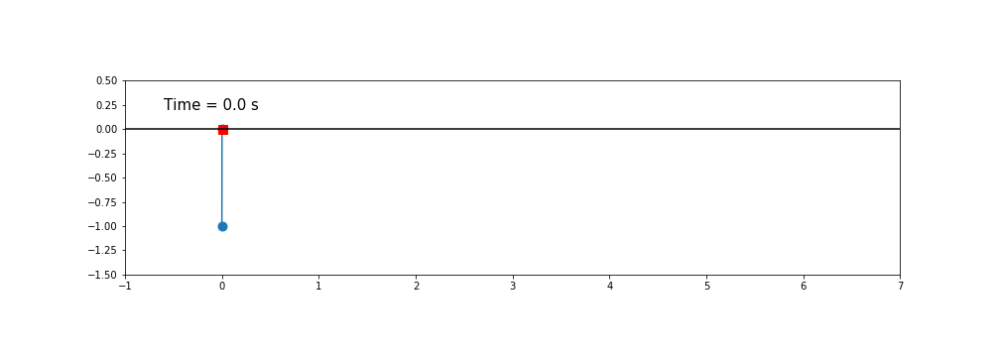
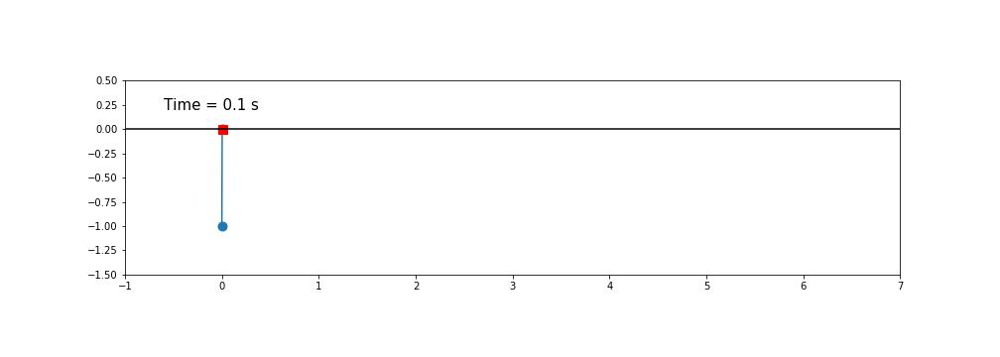
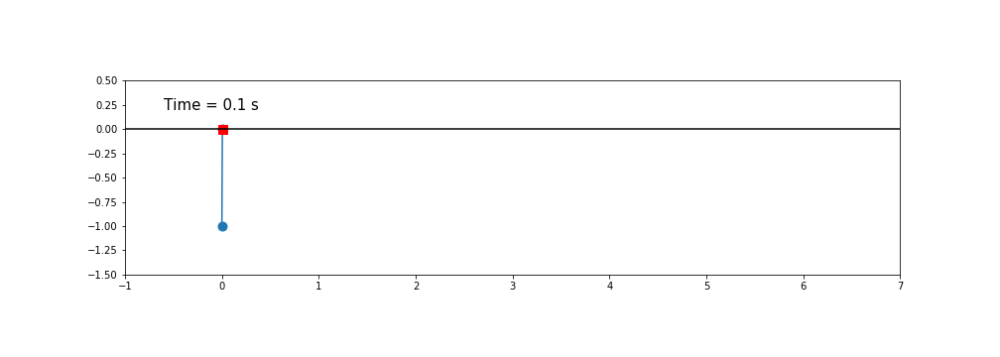
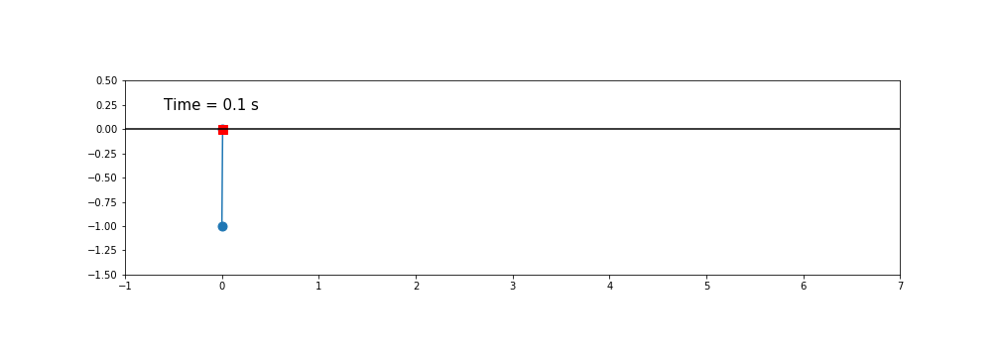
...
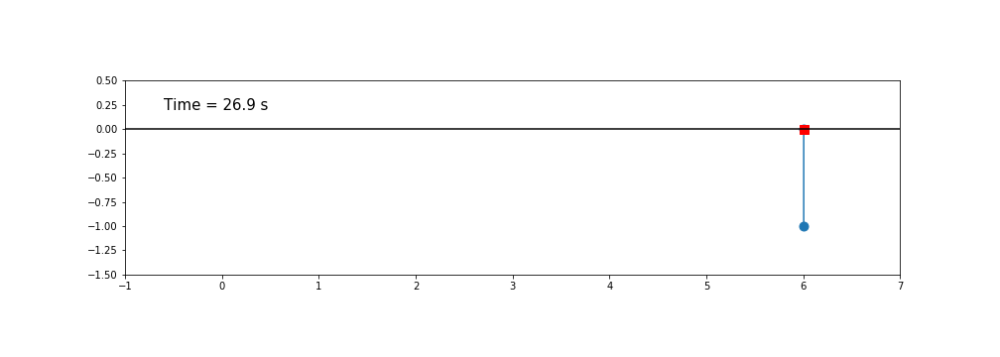
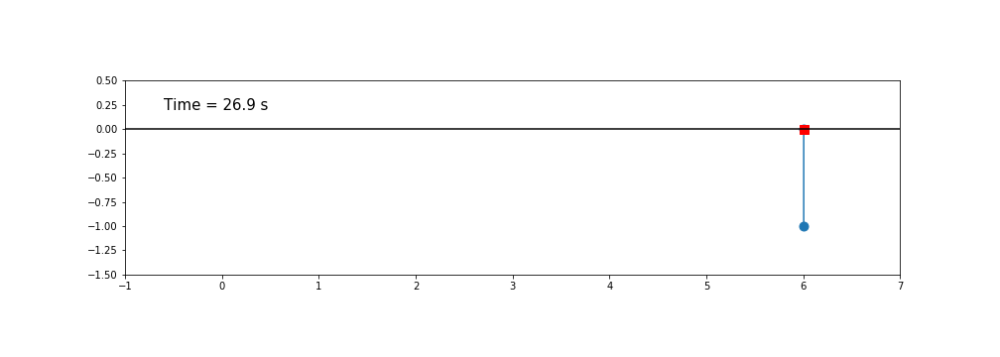
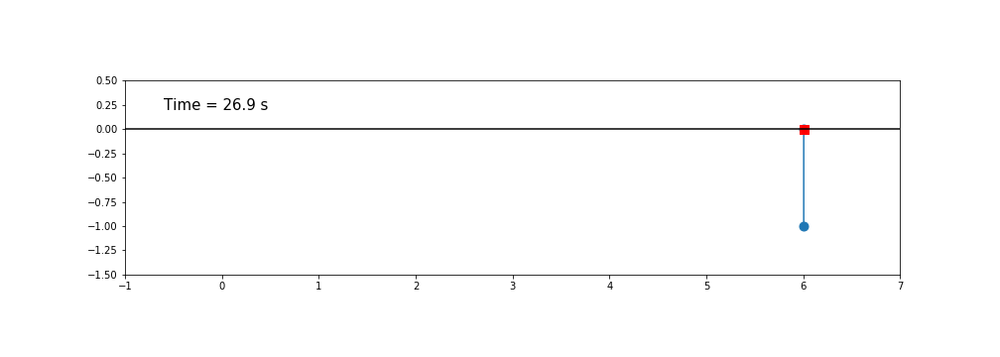
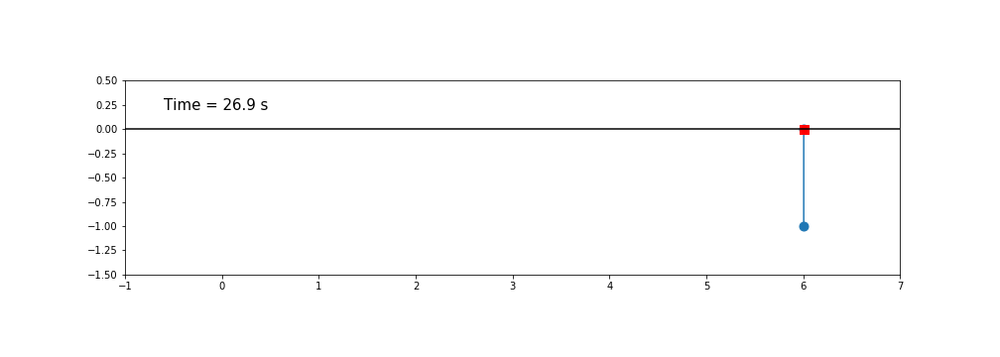
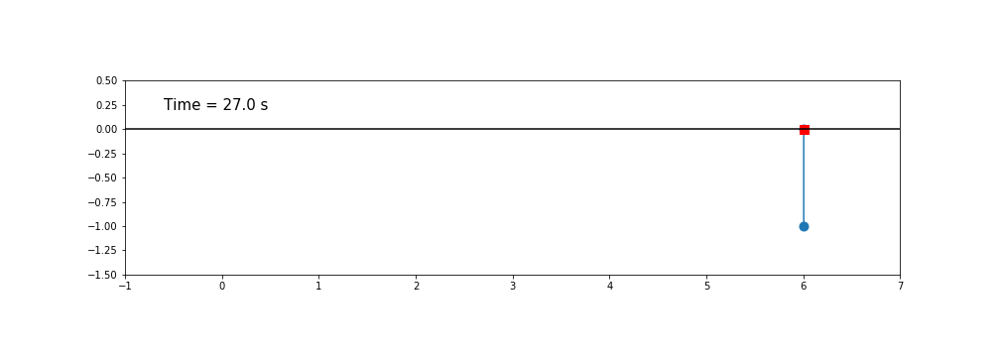

In [8]:
# JSAnimation import available at https://github.com/jakevdp/JSAnimation
from JSAnimation import IPython_display
from matplotlib import animation

# create a simple animation
fig = plt.figure(figsize=(14,5))


ax = plt.subplot(1,1,1)
line1, = ax.plot([], [],'-o',ms = 9)
line2, = ax.plot([], [],'-s',ms = 9, color = 'red')
ax.axhline(0,color='black')

plt.xlim(-1,7)
plt.ylim(-1.5,0.5)
ax.set_aspect('equal')

time_template = 'Time = %.1f s'    # prints running simulation time
time_text = ax.text(0.05, 0.85, '', transform=ax.transAxes, size =15)


def init():
    line1.set_data([], [])
    
    return line1,

def animate(i):
    line1.set_data([P[0][i],P[3][i]], [P[1][i],0])
    line2.set_data(P[3][i],0)
    time_text.set_text(time_template%(P[2][i]))
    return line1,

animation.FuncAnimation(fig, animate, init_func=init,
                        frames=900, interval=40, blit=True)

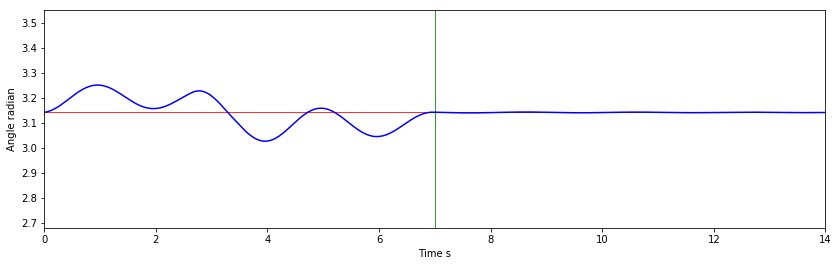

In [9]:
plt.figure(figsize=(14,4))
plt.fill_between(np.array(P[2])[234:],np.array(P[4])[234:], y2=np.pi, color='r', alpha=0.2)
plt.plot(P[2],P[4], color='b')
plt.vlines(7,0,4, lw = 0.8, color='g')
plt.hlines(np.pi,0,15, lw=0.8, color='r')
plt.xlim(0,14)
plt.ylim(2.68,3.55)
plt.xlabel("Time s")
plt.ylabel("Angle radian")
plt.show()